In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import sys
#show the pass to chocolat module
sys.path.append('../')
plt.rcParams['pdf.fonttype'] = 42

## Load Anndata objects of CHOCOLAT-G2P experiments

In [3]:
from chocolat.plt import plot_annotations

In [4]:
andata_folder = '../data/composed_anndata_objects_2024_01_30'

# List all files in the 'tidy' folder
file_list = os.listdir(andata_folder)

adata_dict = {}
for file in file_list:
    if file.endswith('.h5ad'):
        ref_code = file[:-5]  # Remove the '.h5ad' extension
        
        filepath = os.path.join(andata_folder, file)
        adata = sc.read_h5ad(filepath)
        adata.obsm['spatial'] = adata.obsm['spatial'].astype(int) # To ensure spatial coordinates are numerical
        adata.obs['histo_annotation_num'][[str(x).startswith("Normal") for x in adata.obs['histo_annotation_num']]] = 'NaN' # Remove normal annotation from numberical ids
        adata.obs['histo_annotation_num'] = adata.obs['histo_annotation_num'].cat.remove_unused_categories()
        adata_dict[ref_code] = adata


Plot all samples, first 6 are main ROIs, the rest 5 are replicas

In [5]:
all_rois = ['ML_I_2', 'ML_II_B', 'ML_II_C', 'ML_III_A', 'ML_III_B', 'ML_II_A_1'] + ['ML_II_B_3Cyt', 'ML_II_A_3Cyt', 'ML_III_A_2Cyt', 'ML_I',
       'ML_II_A_2']

keys_6ROI = ['ML_I_2', 'ML_II_B', 'ML_II_C', 'ML_III_A', 'ML_III_B', 'ML_II_A_1']

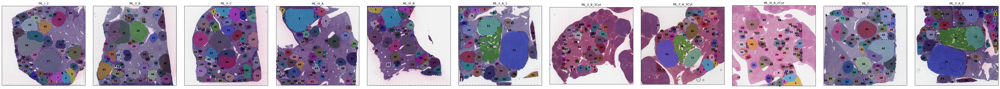

In [6]:
fig = plt.figure(layout='constrained', figsize=((5 * len(all_rois), 5)))
subfigs = fig.subfigures(1, len(all_rois), wspace=0.07)

# Convert the numpy array of Axes objects to a list

for i, k in enumerate(all_rois):
    ax = subfigs[i].subplots(1, 1, sharey=True)
    plot_annotations(adata_dict[k], 'histo_annotation_num',
                 exclude_mask=((adata_dict[k].obs['histo_annotation'] == 'normal_tissue') |
                               ([x.startswith("Normal") for x in adata_dict[k].obs['histo_annotation']]) |
                               (adata_dict[k].obs['histo_annotation_num'] == 'NaN')),
                    ax=ax, border=[0 if k.endswith('Cyt') else 40][0], lims=[None if k.endswith('Cyt') else (580, 600)][0])
    
    ax.set_title(k)
    # ax.set_rasterization_zorder(3)
    
# plt.savefig('../raw_figs/nodules-enumerated-all.pdf')

## Data preprocessing

Now we need to filter out spots which have unusually low or hight UMI counts to clean the input data for the model. Also we should select normal regions as those will inform the model of the background barcode detection rate. In order to avoid contamination with cancer cells, regions are selected at a distance from annotated cancer nodules.
In case of `Cyt` (Cytasist) samples, border regions have unusually high UMI, so they are filtered out as well.

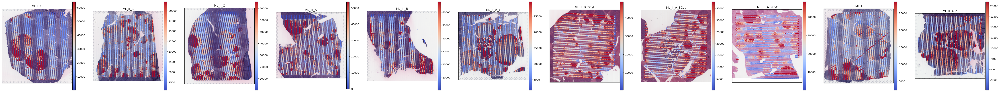

In [7]:
#Plotting UMI counts

fig = plt.figure(layout='constrained', figsize=((5 * len(all_rois), 5)))
subfigs = fig.subfigures(1, len(all_rois), wspace=0.07)

for i, k in enumerate(all_rois):
    ax = subfigs[i].subplots(1, 1, sharey=True)
    adata = adata_dict[k].copy()
    adata.obs['UMI_total'] = adata.X.sum(1)
    sc.pl.spatial(adata, img_key="lowres", color='UMI_total', ax=ax, show=False, vmax='p90', cmap='coolwarm')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(k)

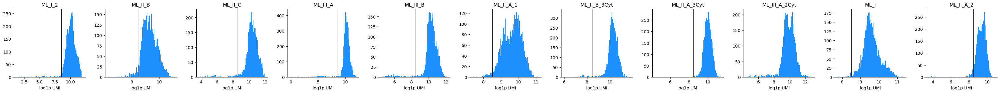

In [8]:
# Chosen thresdhold is 5000 counts, to filter out low quality spots

fig = plt.figure(layout='constrained', figsize=((3 * len(all_rois), 3)))
subfigs = fig.subfigures(1, len(all_rois), wspace=0.07)
for i, k in enumerate(all_rois):
    ax = subfigs[i].subplots(1, 1, sharey=True)
    ax.hist(np.log1p(adata_dict[k].X.sum(1)), bins=100, color='dodgerblue');
    ax.axvline(np.log1p(5000), c='k')
    ax.spines[['right', 'top']].set_visible(False)
    ax.set_title(k)
    ax.set_xlabel('log1p UMI')
    # ax.set_xscale('log', base=10)

In [9]:
from chocolat.preprocessing import annotate_normal_cancer

# Chosen distances from nearest nodule and extra border gaps
th_dist_dict = {'ML_II_C': 600, 'ML_II_B_3Cyt': 800, 'ML_II_B': 800, 'ML_II_A_3Cyt': 800,
 'ML_III_A': 1300, 'ML_III_A_2Cyt': 800, 'ML_I': 1300, 'ML_II_A_2': 1000, 'ML_II_B_2Cyt': 600,
 'ML_II_A_1': 1000, 'ML_III_B': 400, 'ML_I_2': 800}

th_row_dict = {'ML_II_C': None, 'ML_II_B_3Cyt': None, 'ML_II_B': None, 'ML_II_A_3Cyt': None,
 'ML_III_A': None, 'ML_III_A_2Cyt': None, 'ML_I': None, 'ML_II_A_2': None, 'ML_II_B_2Cyt': None,
 'ML_II_A_1': None, 'ML_III_B': 20, 'ML_I_2': 60}

# UMI minimal threshold 
umi_th = 5000

for i, key in enumerate(list(adata_dict.keys())):
    #annotate normal regions
    annotate_normal_cancer(adata_dict[key], th=th_dist_dict[key], row_th=th_row_dict[key], col_th=None)
    
    #annotate good UMI spots
    adata_dict[key].obs['UMI_good'] = np.array(adata_dict[key].X.sum(1) > umi_th)[:,0].astype(int)
    
    #indicate borders
    ymin, ymax = adata_dict[key].obs['array_row'].astype(int).min(), adata_dict[key].obs['array_row'].astype(int).max()
    xmin, xmax = adata_dict[key].obs['array_col'].astype(int).min(), adata_dict[key].obs['array_col'].astype(int).max()
    adata_dict[key].obs['border_filter'] = 0
    adata_dict[key].obs.loc[(adata_dict[key].obs['array_row'].astype(int) > ymin + 1) & (adata_dict[key].obs['array_row'].astype(int) < ymax - 1)
                   & (adata_dict[key].obs['array_col'].astype(int) > xmin + 1) & (adata_dict[key].obs['array_col'].astype(int) < xmax - 1), 'border_filter'] = 1
    
    #indicate good spots
    adata_dict[key].obs['spot_ok'] = 0
    if key.endswith('Cyt'):
        adata_dict[key].obs.loc[(adata_dict[key].obs['UMI_good'] == 1) & (adata_dict[key].obs['border_filter'] == 1), 'spot_ok'] = 1
    else:
        adata_dict[key].obs.loc[(adata_dict[key].obs['UMI_good'] == 1), 'spot_ok'] = 1
        
    #included in the analysis 
    adata_dict[key].obs['passed_filter'] = (adata_dict[key].obs['histo_decision'] != 'excluded') & (adata_dict[key].obs['spot_ok'] == 1)

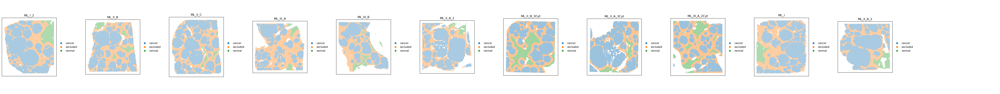

In [10]:
# Histological annotations
fig = plt.figure(layout='constrained', figsize=((5 * len(all_rois), 5)))
subfigs = fig.subfigures(1, len(adata_dict.keys()), wspace=0.07)

for i, k in enumerate(all_rois):
    ax = subfigs[i].subplots(1, 1, sharey=True)
    sc.pl.spatial(adata_dict[k], img_key=None, color='histo_decision', ax=ax, show=False)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(k)

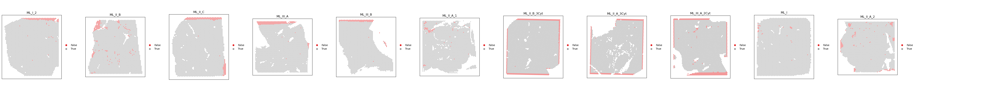

In [11]:
# Bad spot exclusion
fig = plt.figure(layout='constrained', figsize=((5 * len(all_rois), 5)))
subfigs = fig.subfigures(1, len(adata_dict.keys()), wspace=0.07)

for i, k in enumerate(all_rois):
    ax = subfigs[i].subplots(1, 1, sharey=True)
    ad = adata_dict[k].copy()
    ad.obs['spot_ok'] = ad.obs['spot_ok'].astype(bool).astype(str)
    sc.pl.spatial(ad, img_key=None, color='spot_ok', ax=ax, show=False, palette='Set1')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(k)

In [12]:
# Store filtered anndata arrays

adata_dict_filtered = {}

filtered_anndata_folder = '../data/filtered-anndata'

for k in all_rois:
    adata_dict_filtered[k] = adata_dict[k][adata_dict[k].obs['passed_filter']].copy()
    adata_dict_filtered[k].write(os.path.join(filtered_anndata_folder, f'{k}.h5ad'))

# adata_dict_filtered = {k:adata_dict[k][adata_dict[k].obs['passed_filter']].copy() for k in all_rois}

## Converting barcode expression into perturbation probabilities  

In [13]:
import torch
import pyro
from tqdm import tqdm
from chocolat.models import ModelGenotyping, GuideGenotyping, train_genotype_models, prepare_data4genotype_models, region_point_estimates
from chocolat.plt import plot_spatial_pertrubation_probabilities

In [14]:
# Get plasmid-barcode correspondence
plasmids_df = pd.read_csv('../data/plasmid_code.csv')
plasmids_matrix = pd.pivot_table(plasmids_df, index='List', columns='Name', values='FeatureType',
                                 aggfunc=lambda x: 1, fill_value=0)

plasmids_ordered_list = ['MYC-plasmid', 'mtCtnnb1', 'coVEGFA-plasmid',
                         'shMLL3-plasmid', 'NICD-plasmid', 'shRen-plasmid', 'shtrp53-plasmid', 'shPTEN-plasmid']
plasmids_matrix = plasmids_matrix.loc[plasmids_ordered_list]
reporters = list(plasmids_matrix.columns)
plasmids = list(plasmids_matrix.index)
plasmid_matrix = plasmids_matrix.values



In [15]:
data, umi, region_ids_tensor, plasmid_matrix_tensor = prepare_data4genotype_models(adata_dict_filtered, reporters, plasmid_matrix,
                                                                                  region_id_column='histo_annotation_num',
                                                                                  keys=None,
                                                                                  device='cuda')

Prepared data for the following samples: 
ML_I_2, ML_II_B, ML_II_C, ML_III_A, ML_III_B, ML_II_A_1, ML_II_B_3Cyt, ML_II_A_3Cyt, ML_III_A_2Cyt, ML_I, ML_II_A_2


In [16]:
# Train models
models, guides, optimizers, svi_dict, samples_dict = train_genotype_models(data,
                                                                           umi,
                                                                           region_ids_tensor,
                                                                           plasmid_matrix_tensor,
                                                                           max_range=6, # model parameter, maximum plasmid copy number 
                                                                           num_iters=10000,
                                                                           lr=0.01,
                                                                           keys=all_rois, 
                                                                           save_filename='../data/model_outputs/samples_genotyping_model.npy', 
                                                                           return_sites=('region_params', 'spot_sensitivity'),
                                                                           num_samples=1000,
                                                                           seed=42)

Starting model training, the restults will be saved to ../data/model_outputs/samples_genotyping_model.npy


Processing ML_II_A_2: 100%|██████████████████████████| 10000/10000 [04:47<00:00, 34.79it/s, loss=1.4e+5]


In [17]:
# Load saved model samples
with open('../data/model_outputs/samples_genotyping_model.npy', 'rb') as file:
    samples_dict = np.load(file, allow_pickle=True).item()

Inferred probabilities for the main 6 regions

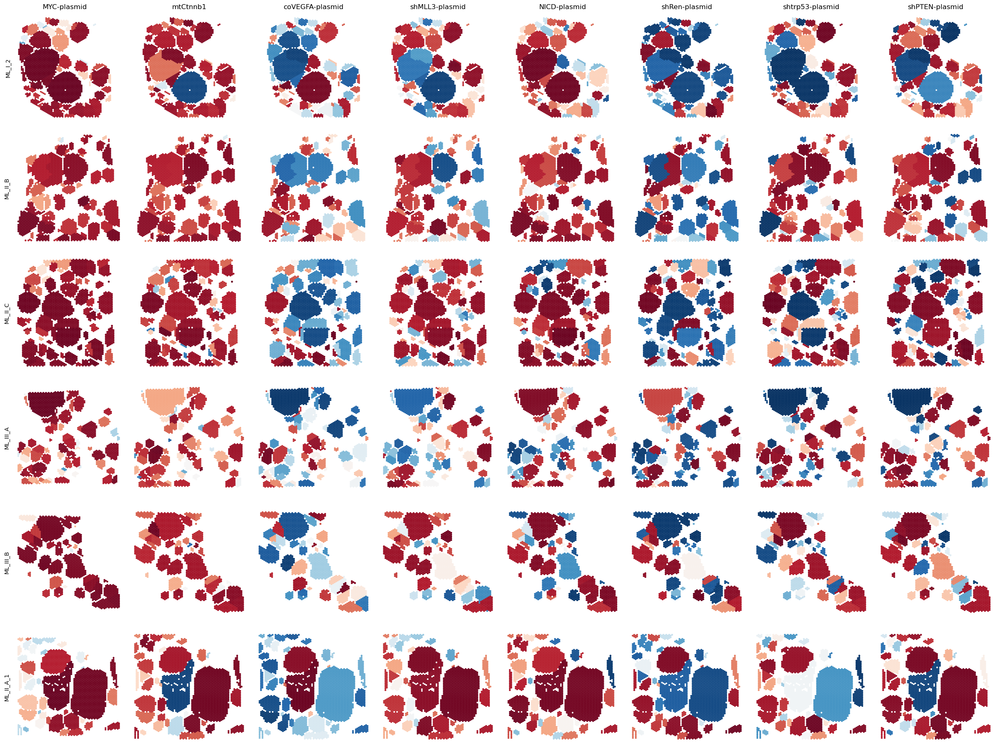

In [18]:
plot_spatial_pertrubation_probabilities(adata_dict_filtered,
                                        samples_dict,
                                        region_ids_tensor,
                                        plasmids=plasmids_ordered_list,
                                        keys=keys_6ROI)

infered probabilities for 5 replicas

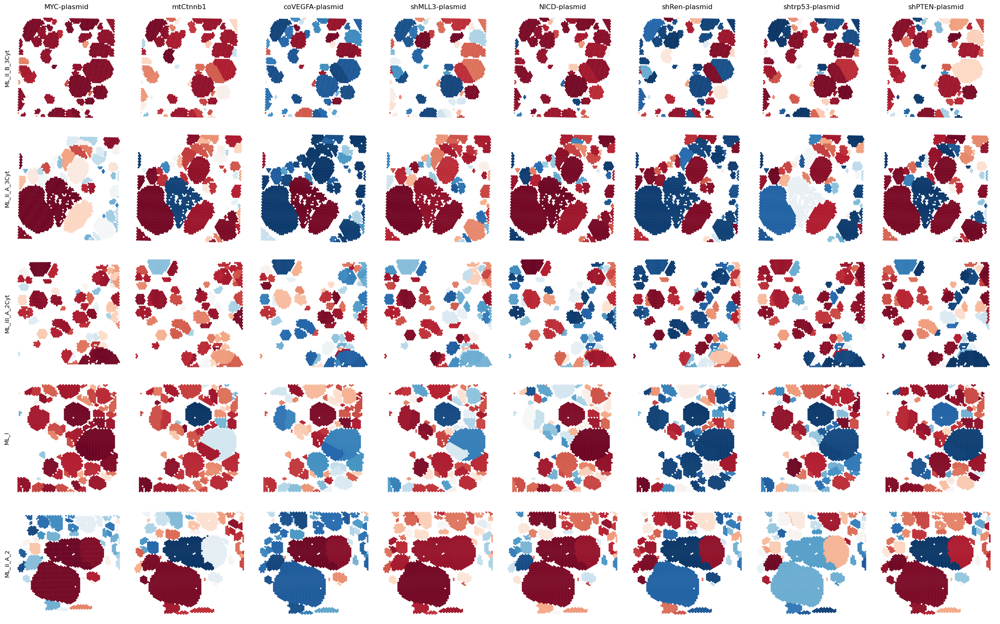

In [19]:
plot_spatial_pertrubation_probabilities(adata_dict_filtered,
                                        samples_dict,
                                        region_ids_tensor,
                                        plasmids=plasmids_ordered_list,
                                        keys=all_rois[6:])

#### Store point estimates for convinience

In [20]:
aggregated_results_dict = region_point_estimates(adata_dict_filtered,
                                                 samples_dict,
                                                 region_ids_tensor,
                                                 plasmids=plasmids_ordered_list)

import pickle as pkl

with open('../data/model_outputs/plasmid_probs-all-samples-final.pkl', 'wb') as file:
    pkl.dump(aggregated_results_dict, file)